In [1]:
# Imports

import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt

from modules.load_data import load_data

---

## Analysis & Visualization

In [2]:
# Load data, print its dimensions and look at first 5 rows 

file_name = 'data/after_EDA.csv'

df = load_data(file_name)
print(df.shape)
df.head()

(1470, 31)


,Age,Attrition,BusinessTravel,DailyRate,Department,DistanceFromHome,Education,EducationField,EnvironmentSatisfaction,Gender,...,PerformanceRating,RelationshipSatisfaction,StockOptionLevel,TotalWorkingYears,TrainingTimesLastYear,WorkLifeBalance,YearsAtCompany,YearsInCurrentRole,YearsSinceLastPromotion,YearsWithCurrManager
0,41,1,Travel_Rarely,1102,Sales,1,2,Life Sciences,2,Female,...,3,1,0,8,0,1,6,4,0,5
1,49,0,Travel_Frequently,279,Research & Development,8,1,Life Sciences,3,Male,...,4,4,1,10,3,3,10,7,1,7
2,37,1,Travel_Rarely,1373,Research & Development,2,2,Other,4,Male,...,3,2,0,7,3,3,0,0,0,0
3,33,0,Travel_Frequently,1392,Research & Development,3,4,Life Sciences,4,Female,...,3,3,0,8,3,3,8,7,3,0
4,27,0,Travel_Rarely,591,Research & Development,2,1,Medical,1,Male,...,3,4,1,6,3,3,2,2,2,2


In [3]:
# Create a variable with names of the numeric features
numeric_cols = list(df.select_dtypes(include=np.number).columns)

# Create a variable with names of the categoric features
categorical_cols = list(df.select_dtypes(include='O').columns) 

### Correlation Heatmap

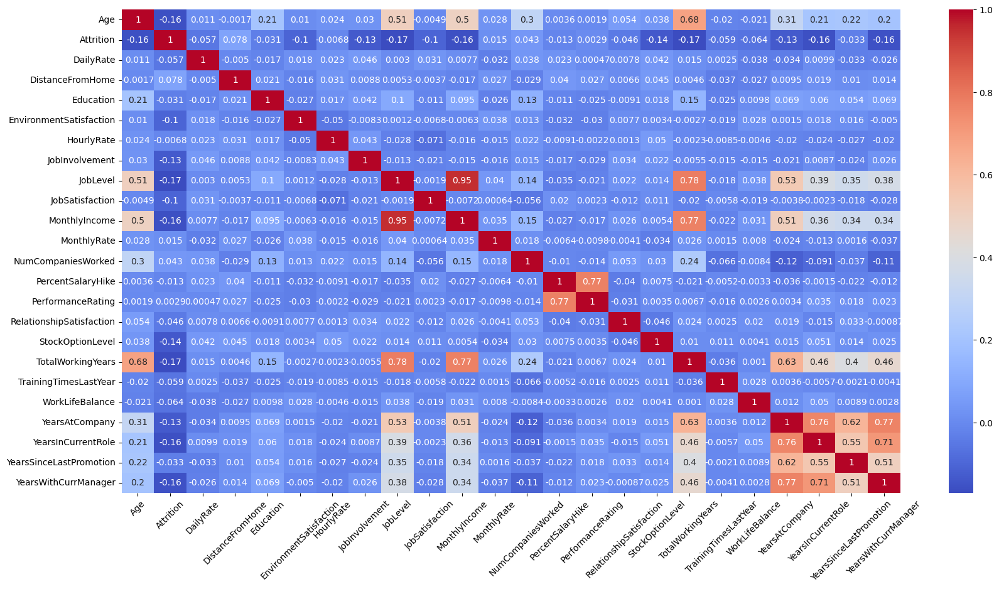

In [4]:
# Build a heatmap showing the correlation between features

fig, ax = plt.subplots(figsize=(20, 10))

sns.heatmap(df.corr(numeric_only=True), annot=True,
            fmt='.2g', ax=ax, cmap='coolwarm')

plt.xticks(rotation=45);
plt.show()

---

**Summary**

* We see a strong positive correlation between job level and monthly income. A more senior employee receives a higher salary. 

* There is also a moderate positive correlation between the age of the employee and how long the person has worked in the company, and between the features showing how long the employee has worked with the current manager/in the current position/in the company.

---

### Distributions

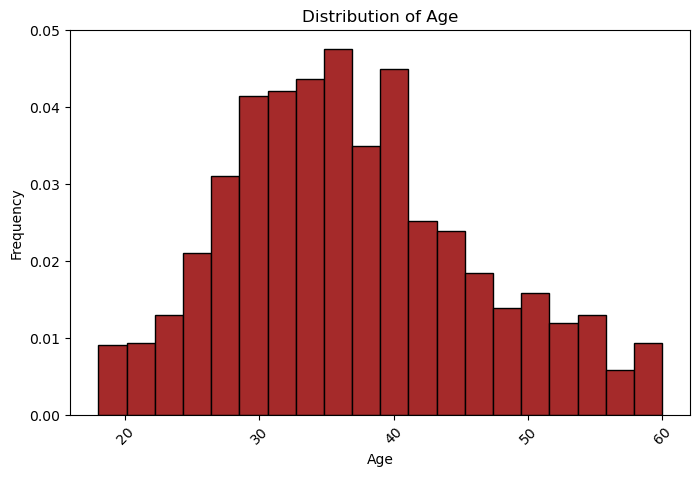

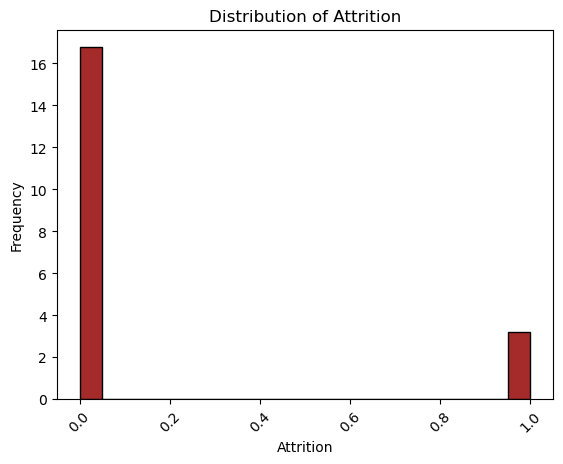

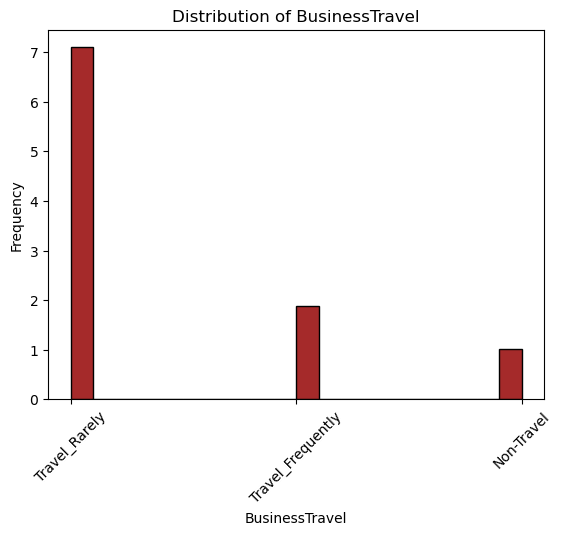

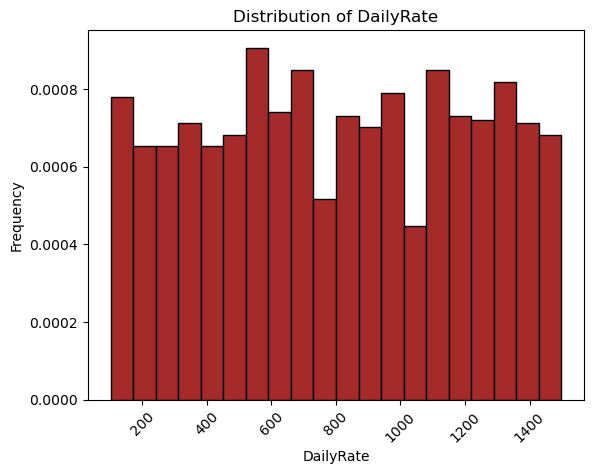

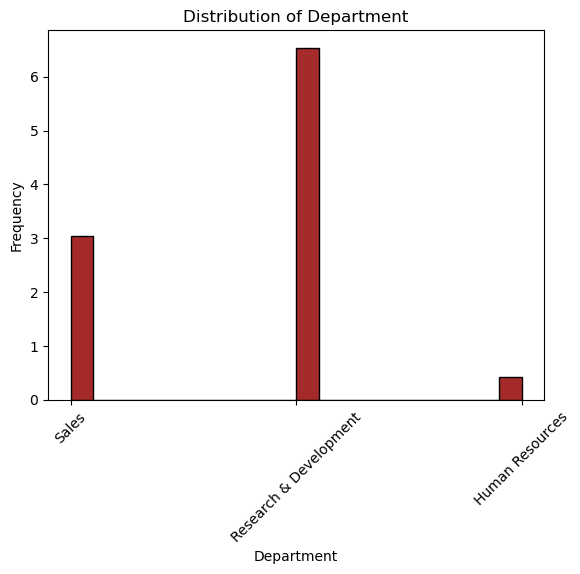

...

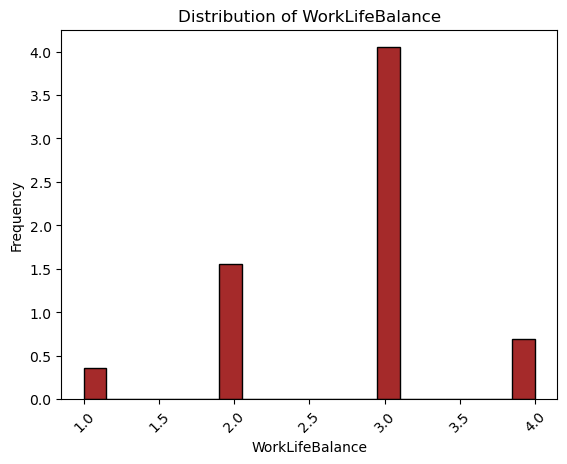

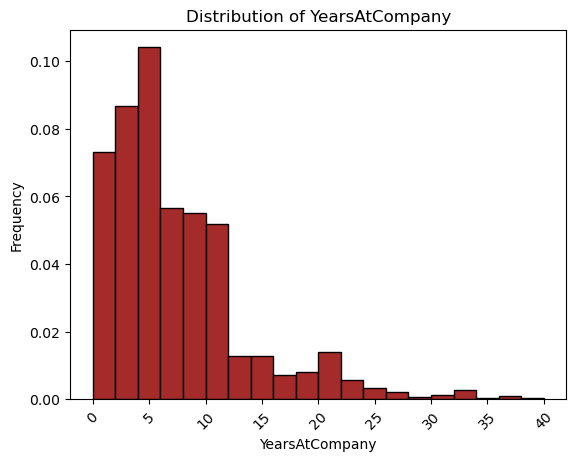

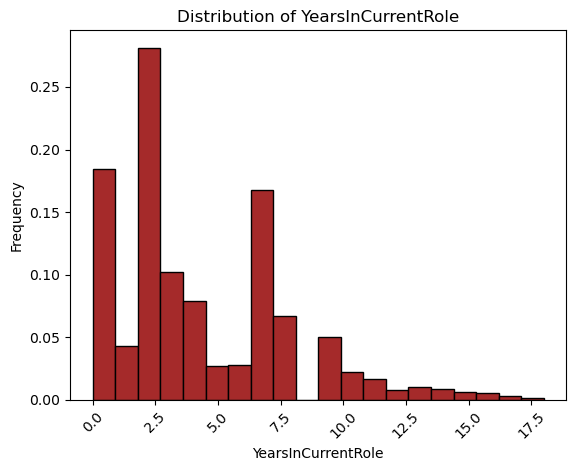

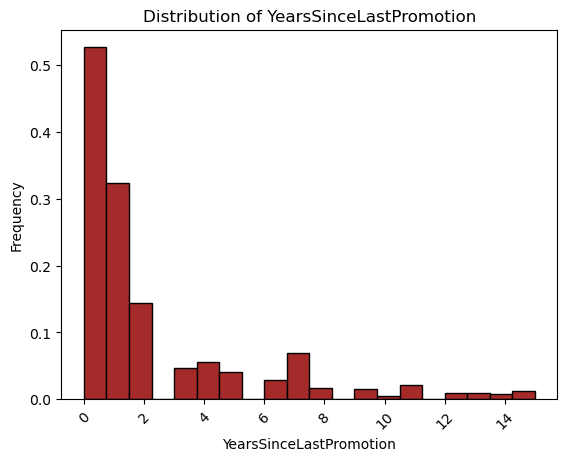

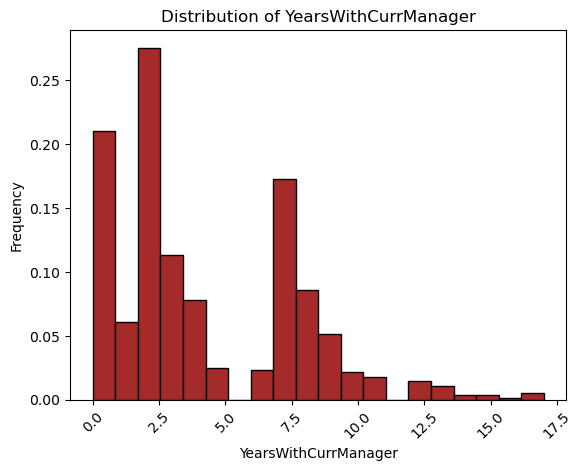

In [5]:
# Display distributions of all features
plt.figure(figsize=(8, 5))

for col in list(df.columns):
    data = df[col]
    plt.hist(data, color='brown', edgecolor='black', density=True, bins=20)
    plt.xticks(rotation=45)
    plt.xlabel(f'{col}')
    plt.ylabel('Frequency')
    plt.title(f'Distribution of {col}')
    plt.show();

### Outliers visualization 

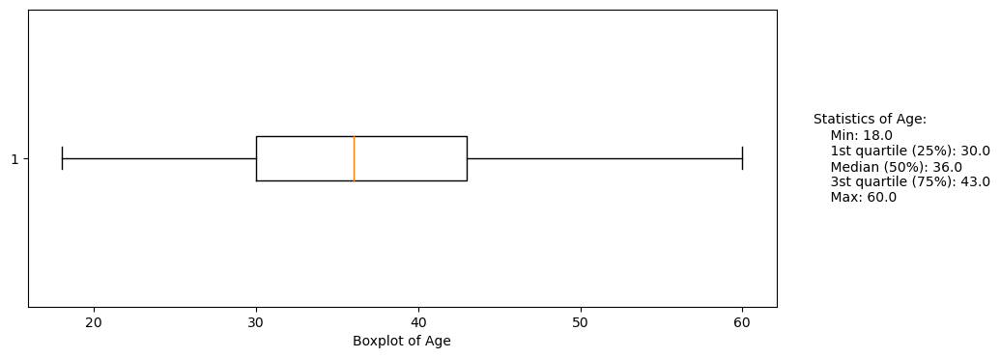

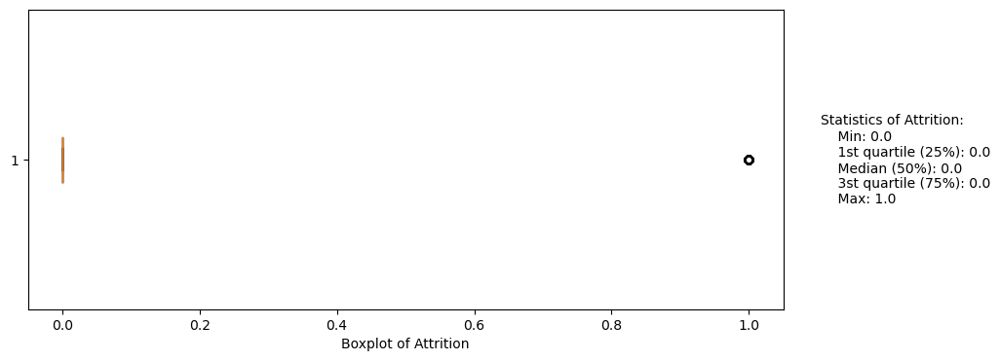

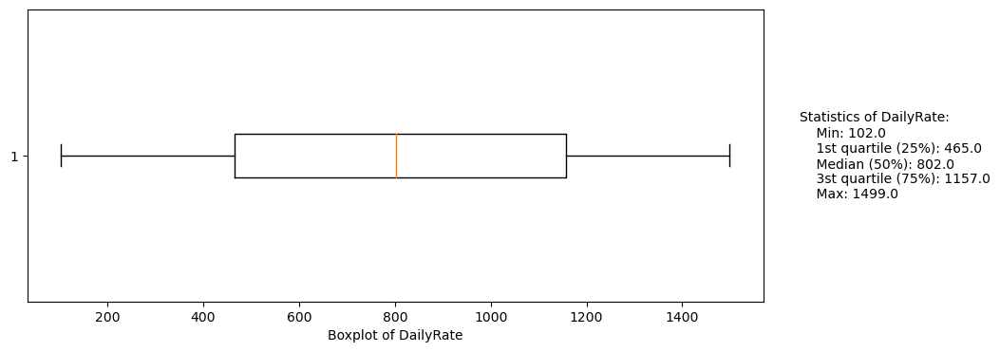

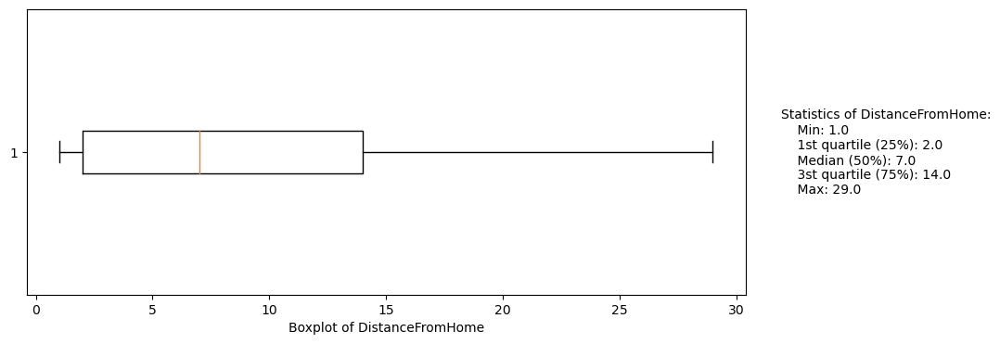

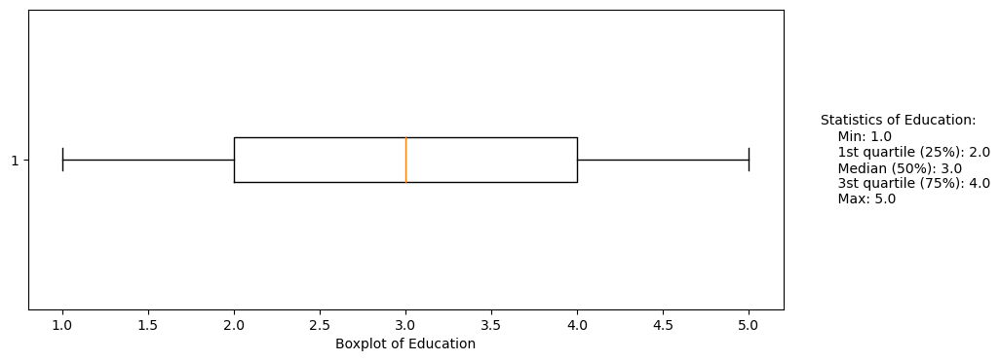

...

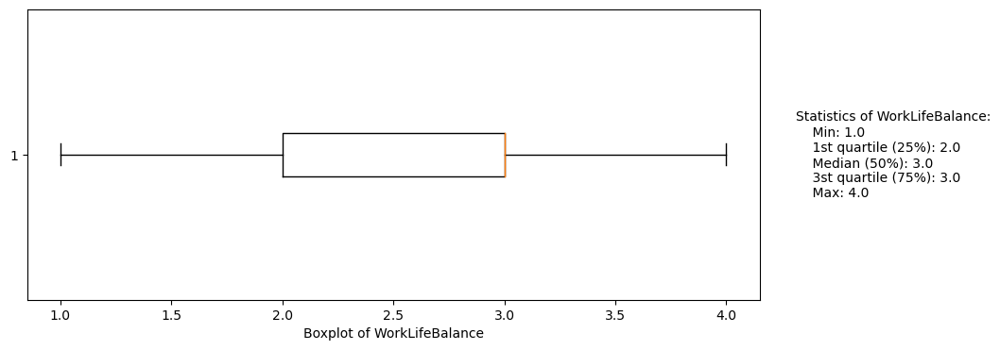

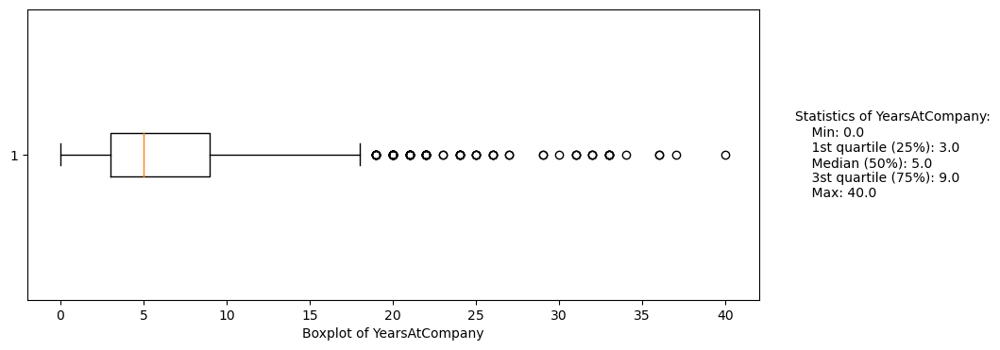

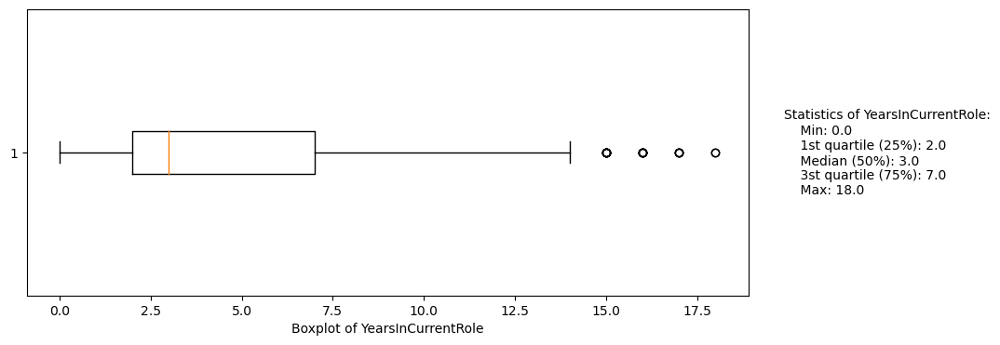

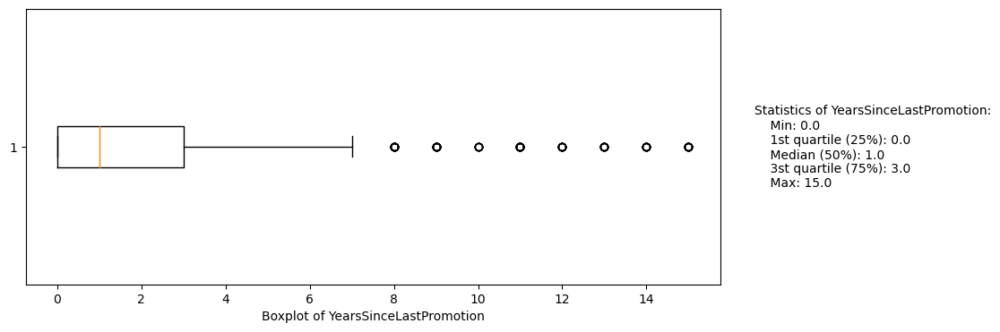

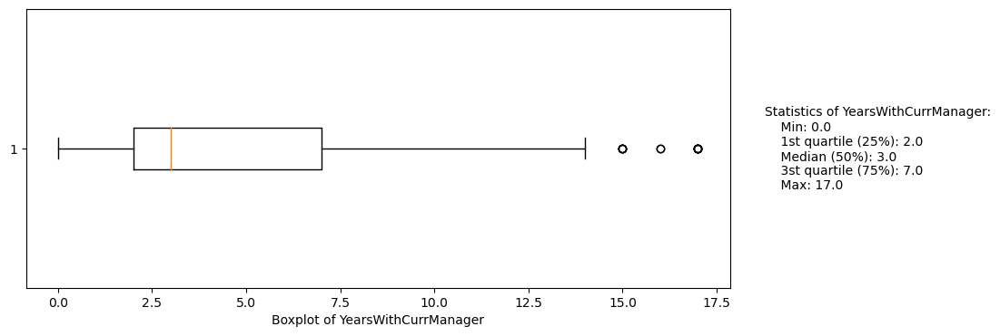

In [6]:
# Display the boxplots for the numerical features along with the statistics

for col in df[numeric_cols]:
    plt.figure(figsize=(10, 4))
    plt.boxplot(df[col], meanline=True, vert=False)
    plt.xlabel(f'Boxplot of {col}')
    describe_list = []
    mn, q1, md, q3, mx = 0, 0, 0, 0, 0 
    for i in df[col].describe()[3:8]:
        describe_list.append(i)
    mn, q1, md, q3, mx = describe_list
    
    legend_text = f'Statistics of {col}:\n\
    Min: {mn}\n\
    1st quartile (25%): {q1}\n\
    Median (50%): {md}\n\
    3st quartile (75%): {q3}\n\
    Max: {mx}\n'
    plt.text(1.05, 0.3, legend_text, transform=plt.gca().transAxes)
    plt.show();

---

**Summary**

* Outliers are detected in a number of features

---

### Scatter plots

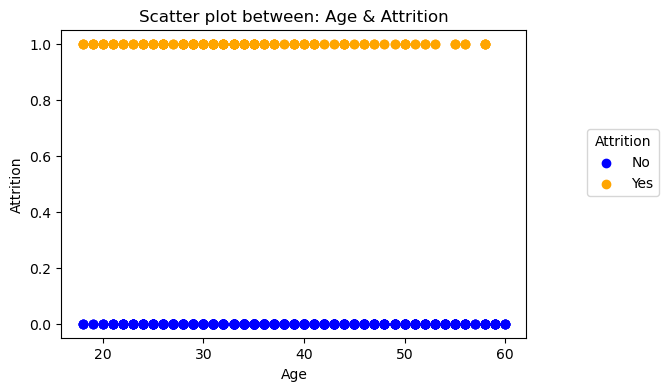

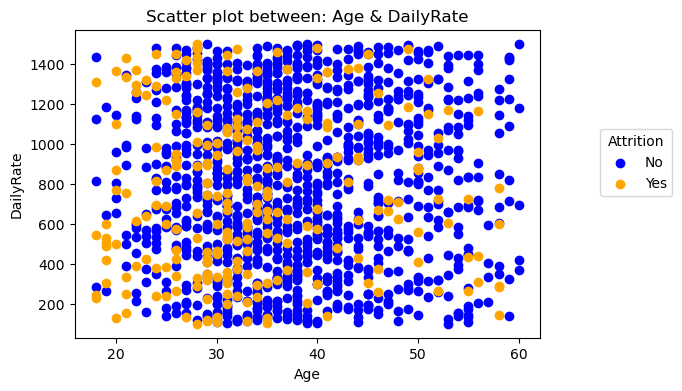

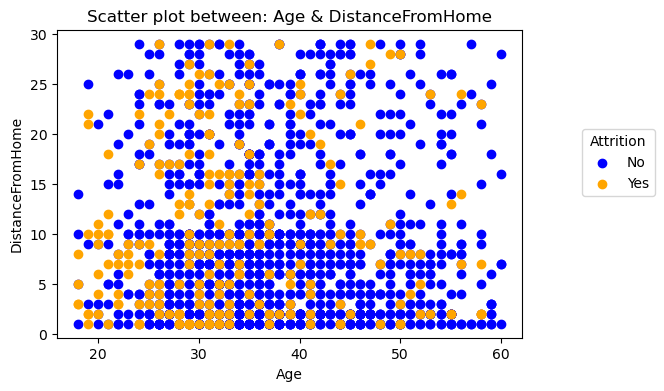

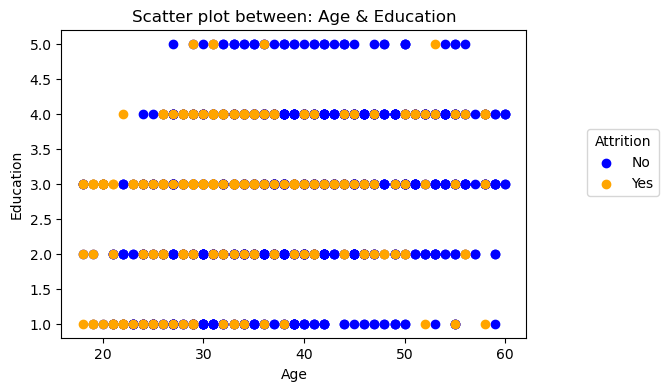

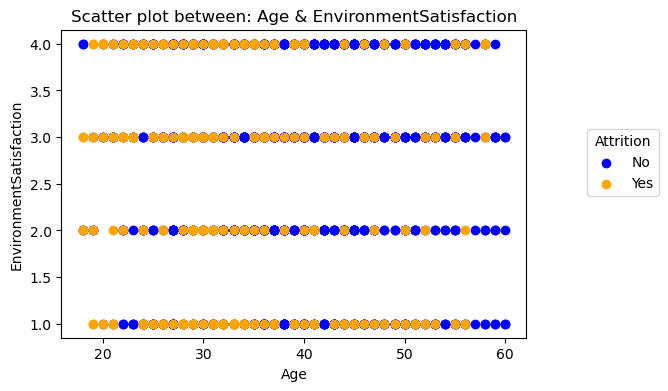

...

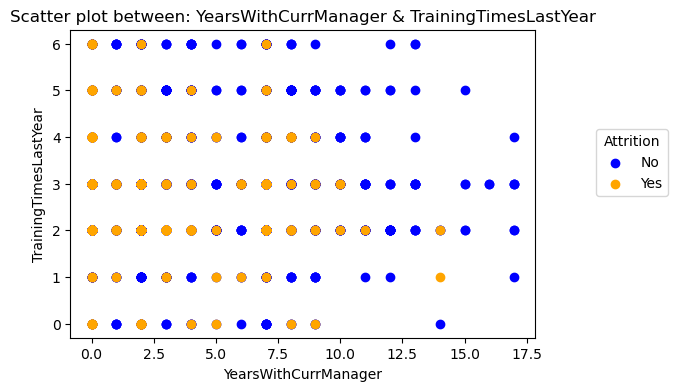

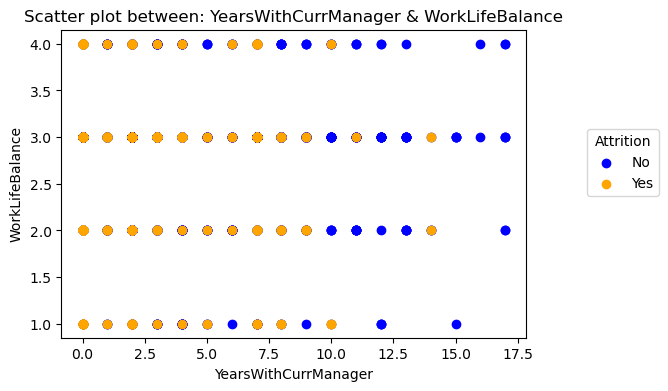

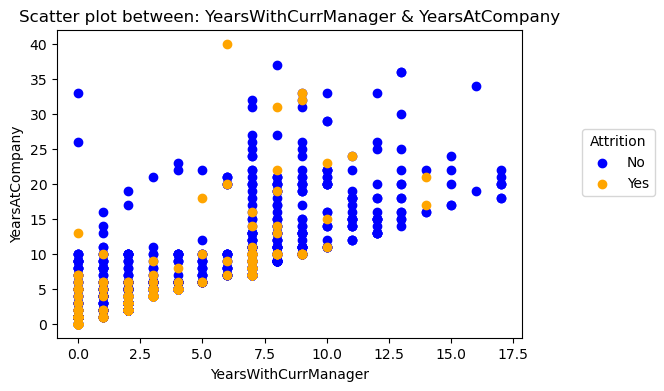

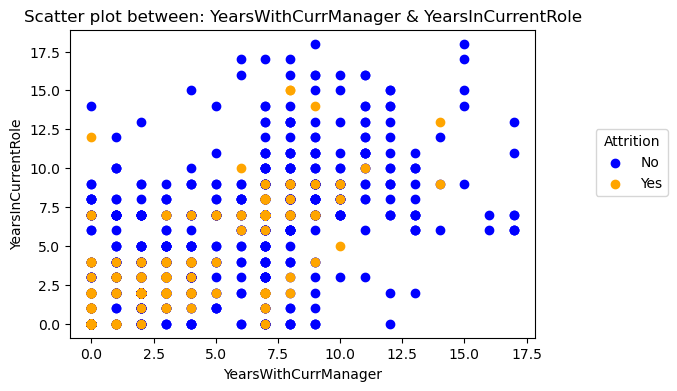

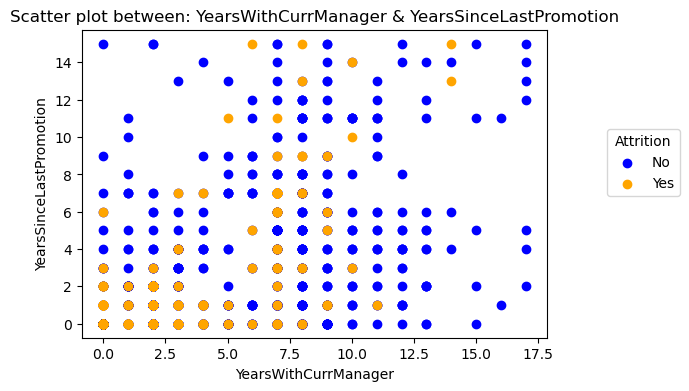

In [7]:
# Display the scatter plots

legend_labels = {'Yes': 1, 'No': 0}

for i, col1 in enumerate(numeric_cols):
    for j, col2 in enumerate(numeric_cols):
        if i != j:
            plt.figure(figsize=(6, 4))

            plt.scatter(df.loc[df['Attrition'] == 0, col1],
                        df.loc[df['Attrition'] == 0, col2], c='b', label='No')
            plt.scatter(df.loc[df['Attrition'] == 1, col1], df.loc[df['Attrition']
                        == 1, col2], c='orange', label='Yes')

            plt.xlabel(col1)
            plt.ylabel(col2)
            plt.title(f'Scatter plot between: {col1} & {col2}')

            # Add a legend
            plt.legend(title='Attrition', loc='best',
                       bbox_to_anchor=(0.8, 0.2, 0.5, 0.5))
            plt.show();

---

**Summary** 

* mostly new employees who have been with the company for less than five years are dismissed.

---

### Dependency visualization

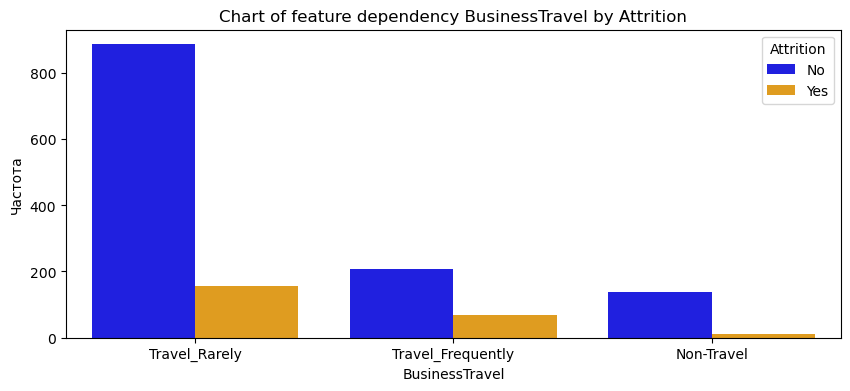

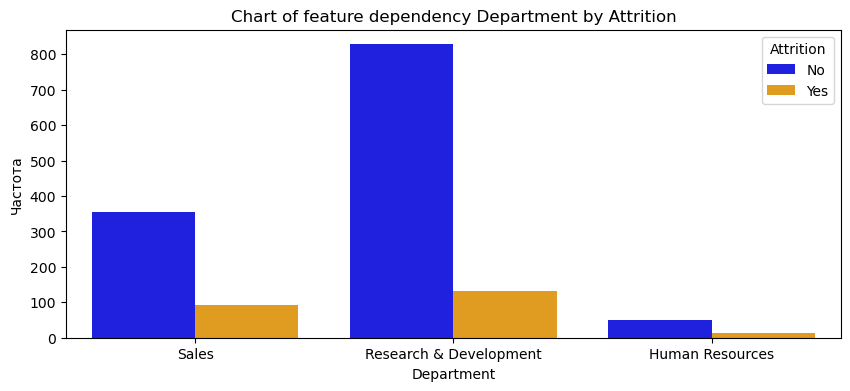

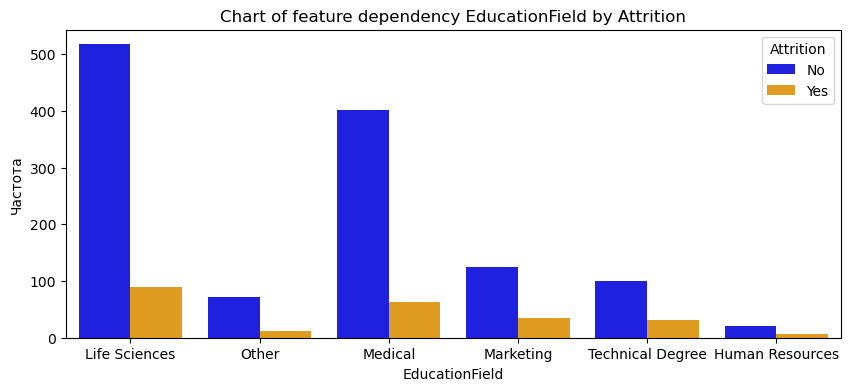

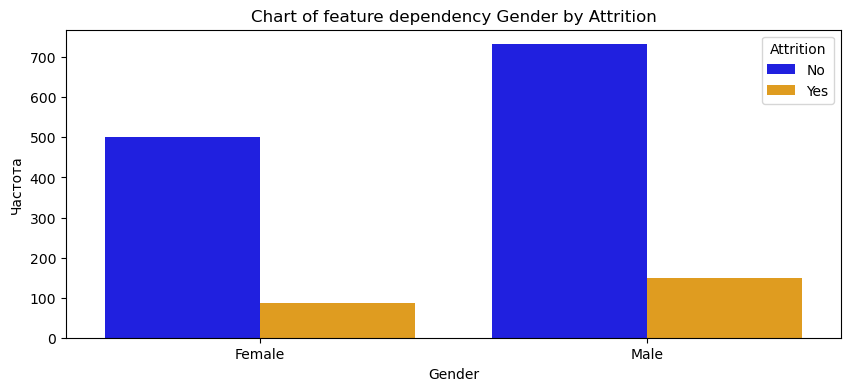

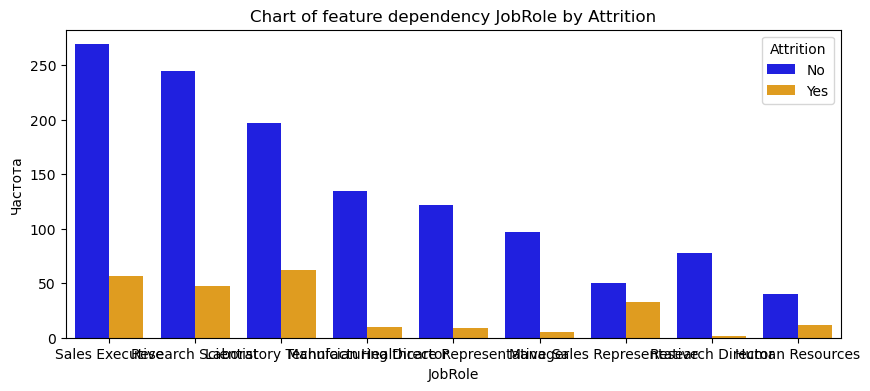

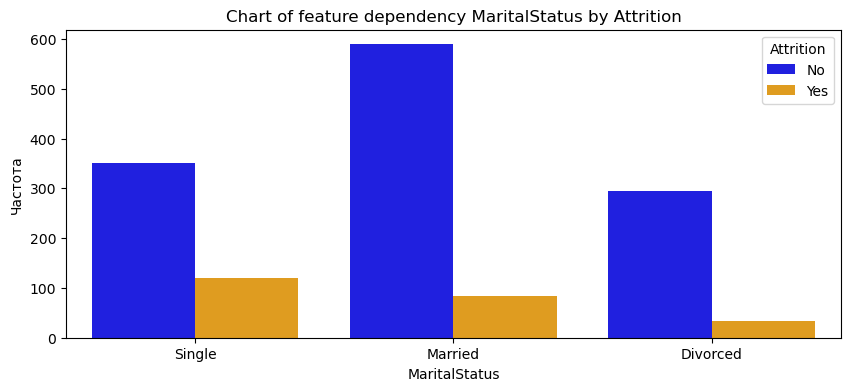

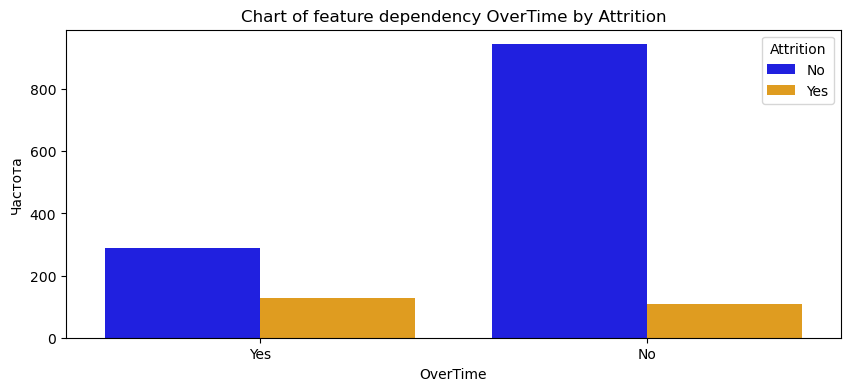

In [8]:
# Draw dependency bar charts for categorical features on the target

custom_palette = {0: 'b', 1: 'orange'}

for col in categorical_cols:
    plt.figure(figsize=(10, 4))
    sns.countplot(data=df, x=col, hue='Attrition', palette=custom_palette)
    plt.title(f'Chart of feature dependency {col} by Attrition')
    plt.xlabel(col)
    plt.ylabel('Частота')
    
    # Add a custom legend for 'No' and 'Yes'
    plt.legend(title='Attrition', labels=['No', 'Yes'], loc='best')
    
    plt.show();

---

**Summary**

* There's nothing special in dependencies. No need to remove anything else yet.

---